In [1]:
import os
from sklearn.model_selection import StratifiedKFold, train_test_split, KFold
from torch.utils.data import TensorDataset, DataLoader
from skimage.io import imread
import matplotlib.pyplot as plt
import numpy as np

from scipy.signal import savgol_filter
from albumentations.pytorch import ToTensorV2
from six.moves import xrange
import random
import umap
import natsort
from skimage.transform import resize


import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
import torch.optim as optim

import torchvision.datasets as datasets
import torchvision.transforms as transforms
from torchvision.utils import make_grid

import pandas as pd
import pickle
import copy
import preprocessing
import utils
import nets_LV
from collections import namedtuple
from utils import img_extended
import albumentations as A
from sklearn import metrics
import itertools

import math          
from sklearn.metrics import roc_curve, precision_recall_curve, auc,average_precision_score,roc_auc_score
from sklearn.preprocessing import label_binarize

from seeds_file import seedEverything


In [2]:
os.environ["CUDA_LAUNCH_BLOCKING"] = "1"
torch.cuda.empty_cache()

In [3]:
seedall = 43
seedEverything(seedall)

In [4]:
idx_to_label = {0: 'non-DR', 1: 'NPDR', 2: 'PDR'}


def getKey(item):
    for idx, label in idx_to_label.items():
        if label == item:
            return idx

        

def getValue(key):
    for idx, label in idx_to_label.items():
        if idx == key:
            return label


In [5]:

class anomalyDetectionB5(Dataset):
    def __init__(self, images,labels, transform=None):
        self.images = images
        self.labels = labels
        self.transform = transform

    def __len__(self):
        return self.images.shape[0]

    def __getitem__(self, idx):
        image = self.images[idx]
        image = (image).astype('uint8')
        label = self.labels[idx]
#         image = image/255
        if self.transform is not None:
            image = self.transform(image=image)["image"]
        return (image/255), label


In [6]:

transform_shape = A.Compose([
#                                 A.SmallestMaxSize(max_size=304),
#                                 A.ShiftScaleRotate(shift_limit=0, scale_limit=0.2, rotate_limit=15),
#                                 A.RandomScale((-.1, .1)),
#                                 A.PadIfNeeded(304, 304, value=0, border_mode=1),
#                                 A.CenterCrop(304, 304),
                                A.HorizontalFlip(),
                                A.RandomResizedCrop(
                                    height = 512,width=512, scale=(0.70, 1)),
#                                 A.RandomRotate90(),
                                A.Rotate(limit=15),
#                                 A.RandomBrightnessContrast(brightness_limit=.10, contrast_limit=.10),
                                A.GaussianBlur(blur_limit=(3), sigma_limit=0.1),
#                                 A.Normalize(mean=(0.470), std=(0.190)),
#                                 A.GaussNoise(var_limit=.0001, )
                                ])


def load_volume(dataset_img):
    dataset_img = np.expand_dims(dataset_img, axis=0)
    dataset_img = (dataset_img).astype('uint8')
  
    return dataset_img



params = {
    "device": "cuda",
    "lr": 0.001,
    "batch_size": 3,
    "num_workers": 4,
    "epochs": 250,
}



/home/optima/hjebril/.local/lib/python3.8/site-packages/albumentations/augmentations/blur/transforms.py:184: UserWarning: blur_limit and sigma_limit minimum value can not be both equal to 0. blur_limit minimum value changed to 3.
  warnings.warn(


In [7]:
# train_transforms = transforms.Compose(
#     [
#         transforms.LoadImaged(keys=["image"]),
#         transforms.EnsureChannelFirstd(keys=["image"]),
#         transforms.ScaleIntensityRanged(keys=["image"], a_min=0.0, a_max=255.0, b_min=0.0, b_max=1.0, clip=True),
#         transforms.RandAffined(
#             keys=["image"],
#             rotate_range=[(-np.pi / 36, np.pi / 36), (-np.pi / 36, np.pi / 36)],
#             translate_range=[(-1, 1), (-1, 1)],
#             scale_range=[(-0.01, 0.01), (-0.01, 0.01)],
#             spatial_size=[64, 64],
#             padding_mode="zeros",
#             prob=0.5,
#         ),
#     ]
# )

In [8]:
import cv2
def visualize_augmentations(dataset, idx=0, samples=5, cols=5):
    dataset2 = copy.deepcopy(dataset)
    dataset2.transform = A.Compose([t for t in dataset.transform if not isinstance(t, (A.Normalize, ToTensorV2))])
#     rows = samples // cols
    figure, ax = plt.subplots(nrows=2, ncols=cols, figsize=(12, 6))
    for i in range(samples):
        image = X_train[i]
        image2, _ = dataset2[i]
        ax[0,i].imshow(image, cmap=plt.cm.gray)
        ax[0,i].set_axis_off()
        ax[0,i].set_title('Original')
        ax[1,i].imshow(image2, cmap=plt.cm.gray)
        ax[1,i].set_title('Augmented')
        ax[1,i].set_axis_off()
        
#     plt.tight_layout()
    plt.show()

In [9]:
def display_image_grid(images, predicted_labels=(), cols=5):
    rows = len(images) // cols
    figure, ax = plt.subplots(nrows=rows, ncols=cols, figsize=(12, 6))
    for i, image in enumerate(images):
        predicted_label = getValue(predicted_labels[i])
        ax.ravel()[i].imshow(image, cmap=plt.cm.gray)
        ax.ravel()[i].set_title(predicted_label)
        ax.ravel()[i].set_axis_off()
    plt.tight_layout()
    plt.show()

In [10]:
data =[]
label = []
filenames = []
ctlist=os.listdir('/optima/exchange/hjebril/challenge/C. Diabetic Retinopathy Grading/1. Original Images/a. Training Set')
ctlist=natsort.natsorted(ctlist)
# read labels from the excel file
dfs_classification = pd.read_csv('/optima/exchange/hjebril/challenge/C. Diabetic Retinopathy Grading/2. Groundtruths/a. DRAC2022_ Diabetic Retinopathy Grading_Training Labels.csv')
dfs_quality = pd.read_csv('/optima/exchange/hjebril/challenge/B. Image Quality Assessment/2. Groundtruths/a. DRAC2022_ Image Quality Assessment_Training Labels.csv')

for idx, filename in enumerate(ctlist):
    x_classification = dfs_classification.loc[dfs_classification['image name'] == filename]['DR grade'].values
    x_qulity = dfs_quality.loc[dfs_quality['image name'] == filename]['image quality level'].values
#     if(x_classification[0] == 0):
    if(x_qulity[0] == 2):
        image = imread('/optima/exchange/hjebril/challenge/C. Diabetic Retinopathy Grading/1. Original Images/a. Training Set/'+filename)
        image = cv2.resize(image, (512, 512))
#         if(image.shape[0]>608):
#             image = cv2.resize(image, (608, 608))
        data.append(image)
        label.append(x_classification[0])
        filenames.append(filename)


In [11]:
data = np.asarray(data)
label = np.asarray(label)

In [12]:
data.shape

(515, 512, 512)

[268, 186, 61]


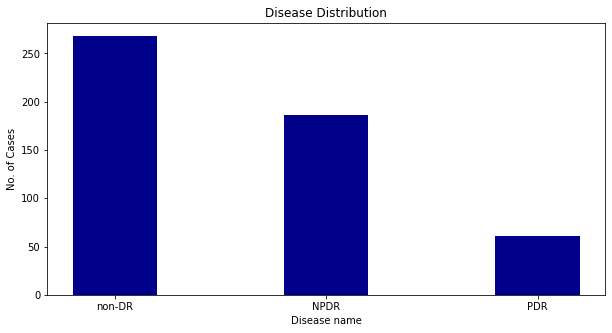

In [13]:
import collections


label_flaten = label.flatten()

counts = collections.Counter(label_flaten)
disease = list(counts.keys())
values = list(counts.values())
print(values)

disease_name = [getValue(i) for i in disease]



  
fig = plt.figure(figsize = (10, 5))
 
# creating the bar plot
plt.bar(disease_name, values, color ='darkblue',
        width = 0.4)
 
plt.xlabel("Disease name")
plt.ylabel("No. of Cases")
plt.title("Disease Distribution")
plt.show()

In [14]:
from sklearn.model_selection import train_test_split,ShuffleSplit


fold = 5


normal_data= data[np.where(label == 0)[0]]
anomolous_data= data[np.where(label != 0)[0]]
normal_label = label[np.where(label == 0)[0]]
anomolous_label = label[np.where(label != 0)[0]]
roc_list = []
kfold2 = ShuffleSplit(n_splits=7, random_state=seedall, train_size=0.8)
for train_ix, test_ix in kfold2.split(normal_data,normal_label):
    # select rows
    X_train, X_rem = normal_data[train_ix], normal_data[test_ix]
    y_train, y_rem = normal_label[train_ix], normal_label[test_ix]
    
    kfold1 = ShuffleSplit(n_splits=6, random_state=seedall, test_size=0.5)
    for valid_ix, test_ix in kfold1.split(X_rem,y_rem):
        # select rows
        X_valid1, X_test1 = X_rem[valid_ix], X_rem[test_ix]
        y_valid1, y_test1 = y_rem[valid_ix], y_rem[test_ix]
            
        kf = StratifiedKFold(n_splits=2, random_state=seedall, shuffle=True)
        for train_idx, test_idx in kf.split(anomolous_data,anomolous_label):
            X_test2, X_valid2 = anomolous_data[train_idx], anomolous_data[test_idx]
            y_test2, y_valid2 = anomolous_label[train_idx], anomolous_label[test_idx]

            X_valid = np.concatenate((X_valid2, X_valid1), axis=0)
            X_test = np.concatenate((X_test2, X_test1), axis=0)
            y_valid = np.concatenate((y_valid2, y_valid1), axis=0)
            y_test = np.concatenate((y_test2, y_test1), axis=0)  


print(X_train.shape)
print(X_test.shape)
print(X_valid.shape)

(214, 512, 512)
(151, 512, 512)
(150, 512, 512)


In [15]:
train_dataset = anomalyDetectionB5(images=X_train,labels = y_train, transform=transform_shape)
valid_dataset = anomalyDetectionB5(images=X_valid,labels = y_valid, transform=None)
test_dataset = anomalyDetectionB5(images=X_test,labels = y_test, transform=None)

train_loader = DataLoader(
    train_dataset, batch_size=params["batch_size"], shuffle=True, num_workers=params["num_workers"], pin_memory=True,
)
valid_loader = DataLoader(
    valid_dataset, batch_size=1, shuffle=False , num_workers=params["num_workers"], pin_memory=True,
)
test_loader = DataLoader(
    test_dataset, batch_size=1, shuffle=False , num_workers=params["num_workers"], pin_memory=True,
)
device = torch.device(params["device"])


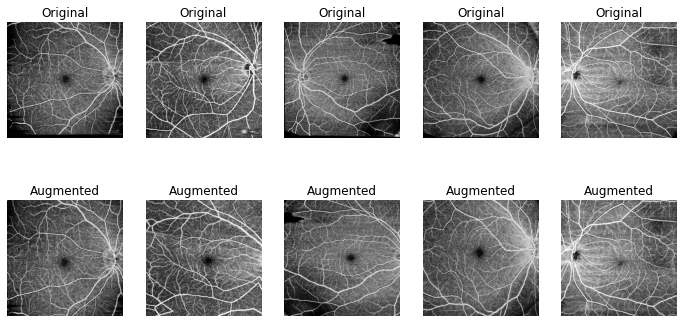

In [16]:
visualize_augmentations(train_dataset)

In [17]:
model = nets_LV.VQVAE(1,n_channels=(16,32,64,128),code_size=128,n_res_block=2,dropout_p=.1)

model.to(device)
optimizer = optim.Adam(model.parameters(), lr=1e-4)


In [18]:
torch.__version__

'1.10.0a0+3fd9dcf'

In [19]:
tracker = utils.train_tracker()
utils.train_epochs(model, optimizer, tracker, train_loader, valid_loader, epochs=params["epochs"], device = device,model_name= 'vqvae')



1 epochs, 0.000 test dice ,3.314 test loss, 3.321 train loss
loss decreased
2 epochs, 0.000 test dice ,1.772 test loss, 2.158 train loss
loss decreased
3 epochs, 0.000 test dice ,1.477 test loss, 1.460 train loss
loss decreased
4 epochs, 0.000 test dice ,0.958 test loss, 0.848 train loss
loss decreased
5 epochs, 0.000 test dice ,0.877 test loss, 0.626 train loss
loss decreased
6 epochs, 0.000 test dice ,0.956 test loss, 0.541 train loss
7 epochs, 0.000 test dice ,0.827 test loss, 0.481 train loss
loss decreased
8 epochs, 0.000 test dice ,0.786 test loss, 0.464 train loss
loss decreased
9 epochs, 0.000 test dice ,0.700 test loss, 0.449 train loss
loss decreased
10 epochs, 0.000 test dice ,0.687 test loss, 0.440 train loss
loss decreased
11 epochs, 0.000 test dice ,0.638 test loss, 0.419 train loss
loss decreased
12 epochs, 0.000 test dice ,0.594 test loss, 0.392 train loss
loss decreased
13 epochs, 0.000 test dice ,0.484 test loss, 0.360 train loss
loss decreased
14 epochs, 0.000 test d

VQVAE(
  (Q): Sequential(
    (0): Conv2d(1, 16, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
    (1): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): GatedResNet(
      (conv1): Conv2d(16, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (norm1): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(16, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (norm2): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (dropout): Dropout2d(p=0.1, inplace=False)
      (gate): GLU(dim=1)
    )
    (3): GatedResNet(
      (conv1): Conv2d(16, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (norm1): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(16, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (norm2): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_run

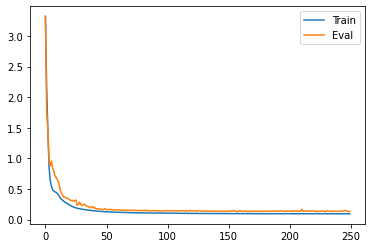

In [20]:
tracker.plot(500)
utils.save_checkpoint(model,optimizer,tracker,'vqvae_codebook_512.pt')

In [21]:

# saveroot = 'earlyStop/drac'
# bestmodelpath = os.path.join(saveroot, 'vqvae',
#                              natsort.natsorted(os.listdir(os.path.join(saveroot, 'vqvae')))[0])
# print('bestmodelpath',bestmodelpath)

In [22]:
# feat_ext_mdl = nets_LV.VQVAE(1,n_channels=(32,64,128,256),code_size=512,n_res_block=2, dropout_p=.1)
# device= "cuda"
# feat_ext_mdl.to(device)
# chpt = torch.load('vqvae_codebook_512.pt')
# feat_ext_mdl.load_state_dict(chpt['model'])


In [23]:

saveroot = 'earlyStop/drac'
bestmodelpath = os.path.join(saveroot, 'vqvae',
                             natsort.natsorted(os.listdir(os.path.join(saveroot, 'vqvae')))[0])
print('bestmodelpath',bestmodelpath)



feat_ext_mdl = nets_LV.VQVAE(1,n_channels=(16,32,64,128),code_size=128,n_res_block=2, dropout_p=.1)
device= "cuda"
feat_ext_mdl.to(device)

feat_ext_mdl.load_state_dict(
    torch.load(bestmodelpath)['model']
)
model = nets_LV.VQLatentSNAIL(feature_extractor_model=feat_ext_mdl,
                              shape=(64,64), n_block = 4, n_res_block = 2, n_channels = 128)
model.to(device)

optimizer = optim.Adam(model.parameters(), lr=1e-4)
tracker = utils.train_tracker()

bestmodelpath earlyStop/drac/vqvae/0.12995.pt


In [24]:
utils.train_epochs(model, optimizer, tracker, train_loader, valid_loader, epochs=500, device = device ,model_name= 'AR')


124.0
1 epochs, 4.830 test loss,  0.827 test Percentile, 4.795 train loss
loss decreased
124.0
2 epochs, 4.701 test loss,  0.827 test Percentile, 4.688 train loss
loss decreased
124.0
3 epochs, 4.636 test loss,  0.827 test Percentile, 4.623 train loss
loss decreased
124.0
4 epochs, 4.565 test loss,  0.827 test Percentile, 4.560 train loss
loss decreased
124.0
5 epochs, 4.519 test loss,  0.827 test Percentile, 4.500 train loss
loss decreased
124.0
6 epochs, 4.487 test loss,  0.827 test Percentile, 4.460 train loss
loss decreased
124.0
7 epochs, 4.460 test loss,  0.827 test Percentile, 4.438 train loss
loss decreased
124.0
8 epochs, 4.434 test loss,  0.827 test Percentile, 4.410 train loss
loss decreased
124.0
9 epochs, 4.411 test loss,  0.827 test Percentile, 4.391 train loss
loss decreased
124.0
10 epochs, 4.385 test loss,  0.827 test Percentile, 4.362 train loss
loss decreased
124.0
11 epochs, 4.356 test loss,  0.827 test Percentile, 4.328 train loss
loss decreased
124.0
12 epochs, 4.

VQLatentSNAIL(
  (ini_conv): MaskedConv()
  (blocks): ModuleList(
    (0): PixelBlock(
      (v_resblocks): ModuleList(
        (0): GatedResNet(
          (conv1): WNConv2d(
            (conv): Conv2d(128, 128, kernel_size=(2, 3), stride=(1, 1), padding=(1, 1))
          )
          (conv2): WNConv2d(
            (conv): Conv2d(128, 256, kernel_size=(2, 3), stride=(1, 1), padding=(1, 1))
          )
          (dropout): Dropout2d(p=0.1, inplace=False)
          (gate): GLU(dim=1)
        )
        (1): GatedResNet(
          (conv1): WNConv2d(
            (conv): Conv2d(128, 128, kernel_size=(2, 3), stride=(1, 1), padding=(1, 1))
          )
          (conv2): WNConv2d(
            (conv): Conv2d(128, 256, kernel_size=(2, 3), stride=(1, 1), padding=(1, 1))
          )
          (dropout): Dropout2d(p=0.1, inplace=False)
          (gate): GLU(dim=1)
        )
      )
      (h_resblocks): ModuleList(
        (0): GatedResNet(
          (conv1): WNConv2d(
            (conv): Conv2d(128, 

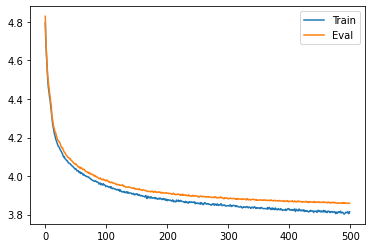

In [25]:
tracker.plot(500)
utils.save_checkpoint(model,optimizer,tracker,'ar_codebook_512.pt')

In [17]:
saveroot = 'earlyStop/drac'


feat_ext_mdl = nets_LV.VQVAE(1,n_channels=(16,32,64,128),code_size=128,n_res_block=2, dropout_p=.1)
device= "cuda"
feat_ext_mdl.to(device)

bestmodelpath = os.path.join(saveroot, 'vqvae',
                             natsort.natsorted(os.listdir(os.path.join(saveroot, 'vqvae')))[0])

print('bestmodelpath',bestmodelpath)
feat_ext_mdl.load_state_dict(
    torch.load(bestmodelpath)['model']
)
    


model = nets_LV.VQLatentSNAIL(feature_extractor_model=feat_ext_mdl,
                              shape=(64,64), n_block = 4, n_res_block = 2, n_channels = 128)
model.to(device)


bestmodelpath = os.path.join(saveroot, 'AR',
                             natsort.natsorted(os.listdir(os.path.join(saveroot, 'AR')))[0])


print('bestmodelpath',bestmodelpath)
model.load_state_dict(
    torch.load(bestmodelpath)['model']
)


bestmodelpath earlyStop/drac/vqvae/0.12995.pt
bestmodelpath earlyStop/drac/AR/3.85783.pt


<All keys matched successfully>

In [18]:
from tqdm import tqdm
from prefetch_generator import BackgroundGenerator

def evaluate_vqvae(net,dataloader,device,nb_forward=15):
    net.eval()
    losses = torch.empty((0,64,64))
    probs_list = []
    loss_list = []
    pbar = tqdm(enumerate(BackgroundGenerator(dataloader)), total=len(dataloader))
    for itr, (test_images, test_annotations) in pbar:
        x = test_images
        # move images and labels to correct device and type
        x = x.to(device=device, dtype=torch.float32)

        # iterate over the forward passes
#         for f_pass in range(nb_forward):
        with torch.no_grad():
            result = net.loss(x, reduction='none')
            loss = result['loss']
            probs = F.softmax(loss, dim=1)
#             losses = torch.cat((losses,loss.cpu()),dim=0)
              # upscale loss
#             up_scl = 8
#             upscale_loss = np.kron(loss.cpu().numpy()[0], np.ones((up_scl,up_scl)))
            probs_list.append(probs.cpu().numpy()[0])
            loss_list.append(loss.cpu().numpy()[0])

    return np.array(loss_list),np.array(probs_list)




In [19]:
losses, softmax_porb = evaluate_vqvae(model,valid_loader,device)

100%|██████████| 150/150 [00:08<00:00, 18.31it/s]


In [20]:
perces = []
perces.append(np.percentile(losses, 99))
perces.append(np.percentile(losses, 98))
perces.append(np.percentile(losses, 97))
perces.append(np.percentile(losses, 96))
perces.append(np.percentile(losses, 95))
perces.append(np.percentile(losses, 94))
perces.append(np.percentile(losses, 93))
perces.append(np.percentile(losses, 92))
perces.append(np.percentile(losses, 91))
perces.append(np.percentile(losses, 90))
perces.append(np.percentile(losses, 89))
perces.append(np.percentile(losses, 88))


In [21]:
perces

[7.2155454826355,
 6.6488114356994625,
 6.324940805435182,
 6.093932151794434,
 5.916335153579712,
 5.76876178741455,
 5.6446520471572885,
 5.538229484558109,
 5.444314427375793,
 5.356721019744873,
 5.2817280483245845,
 5.21239013671875]

In [22]:
def roc_auc_img(gt, score):
    img_roc_auc = roc_auc_score(gt, score)
    
    return img_roc_auc


def cal_img_roc(scores, gt_list):
    img_scores = scores.reshape(scores.shape[0], -1)
#     img_scores = scores.reshape(scores.shape[0], -1).sum(axis=1)
#     print(img_scores)
    gt_list = np.asarray(gt_list)
    fpr, tpr, _ = roc_curve(gt_list, img_scores)
    img_roc_auc = roc_auc_img(gt_list, img_scores)

    return fpr, tpr, img_roc_auc

In [23]:


from sklearn import metrics



def roc_results(data_loader,perces):
    with torch.no_grad():
        mood_test = []
        label_test = []
        for img, label in data_loader:
            mood_test.append(img)
            label_test.append(label.item())
        label_test = np.array(label_test)
    img_roc_auc_all =[]
    for thresh in perces:    
        pred = []
        all_pred_tensor_val = torch.empty((0, 1), dtype=torch.float32).to('cuda')
        model.eval()
        for X in mood_test:
            x_img = X.to(device).float()
            with torch.no_grad():
                codes = model.retrieve_codes(x_img).flatten(1)
                loss = model.loss(x_img, reduction='none')['loss'].flatten(1)
                score1 = torch.sum(loss*(loss>thresh),1).float()
                score1 = score1.unsqueeze(1)
        #         score1 = torch.softmax(score1)
                all_pred_tensor_val = torch.cat((all_pred_tensor_val, score1), 0)
        # pred = np.concatenate(pred,1).reshape(-1,1)

        y_valid_2 = np.where(label_test > 0, 1, 0)

        fpr, tpr, img_roc_auc = cal_img_roc(all_pred_tensor_val.cpu(), y_valid_2)
        plt.plot(fpr, tpr, label='Healthy vs others (area = {0:0.2f})'
                                               ''.format(img_roc_auc))
        plt.plot([0, 1], [0, 1], 'k--')
        plt.xlim([0.0, 1.0])
        plt.ylim([0.0, 1.05])
        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        # label ='AVG ROC = {0:0.2f}'''.format(totl_roc/3)
        plt.title('VQVAE - ROC VAL Results')
        plt.legend(loc="lower right")
        plt.show()
        print(thresh)
        print(img_roc_auc)
        img_roc_auc_all.append(img_roc_auc)
    return img_roc_auc_all

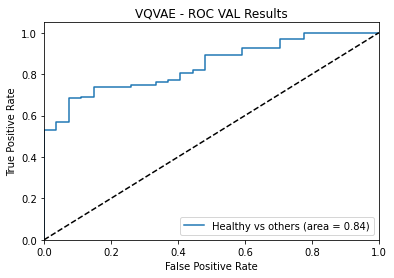

7.2155454826355
0.8425173140620295


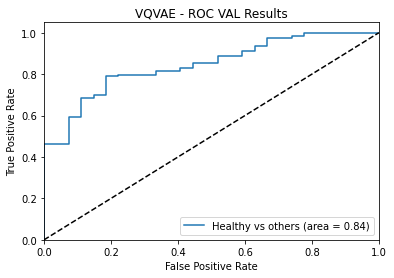

6.6488114356994625
0.8443239987955435


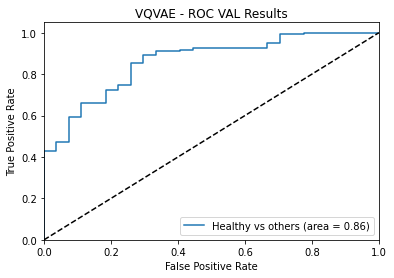

6.324940805435182
0.861788617886179


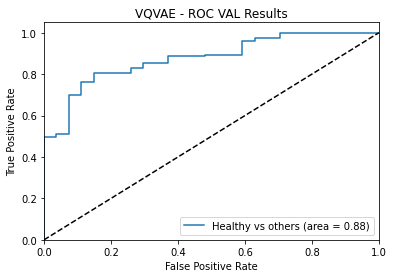

6.093932151794434
0.8768443239987955


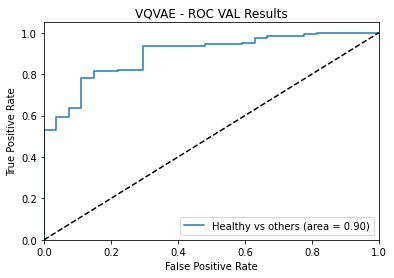

5.916335153579712
0.8955133995784402


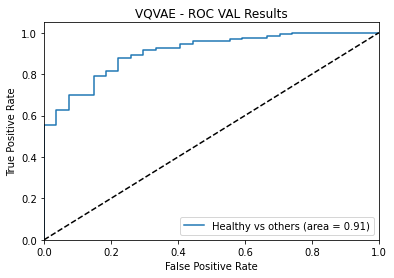

5.76876178741455
0.9051490514905149


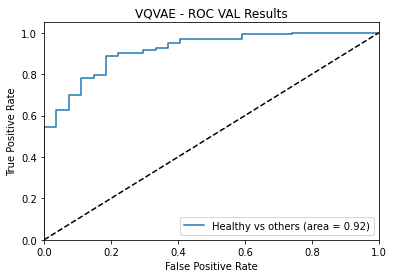

5.6446520471572885
0.9162902740138512


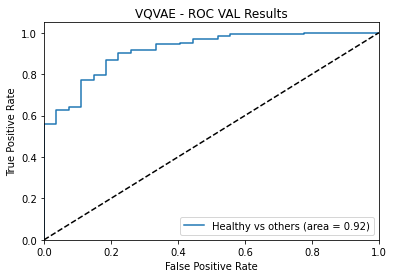

5.538229484558109
0.9153869316470942


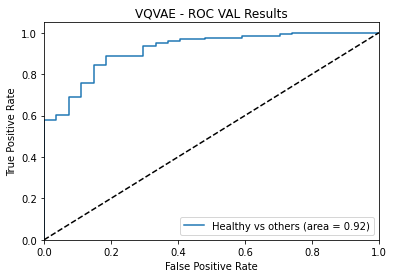

5.444314427375793
0.917795844625113


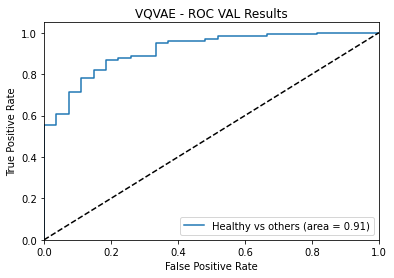

5.356721019744873
0.9147847034025895


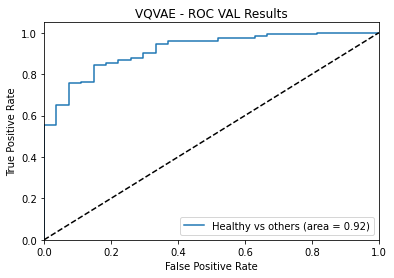

5.2817280483245845
0.915989159891599


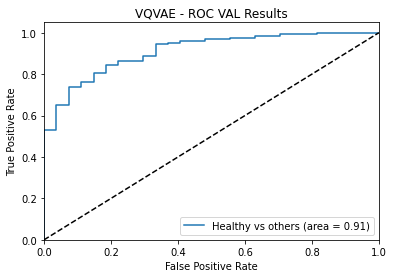

5.21239013671875
0.9105691056910569


In [25]:
img_roc_auc_all = roc_results(valid_loader,perces)

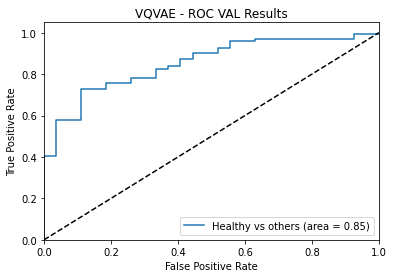

7.2155454826355
0.8521505376344086


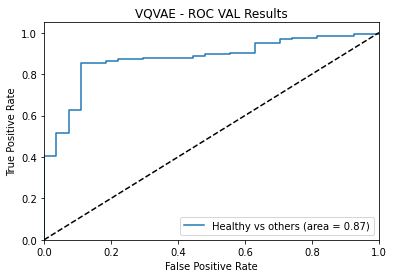

6.6488114356994625
0.8748506571087217


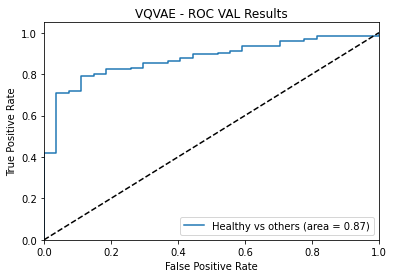

6.324940805435182
0.8733572281959379


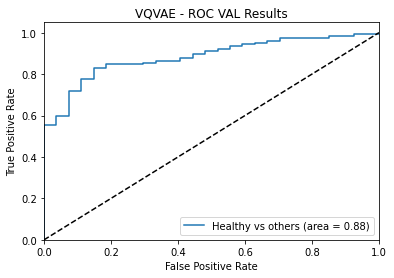

6.093932151794434
0.8832138590203107


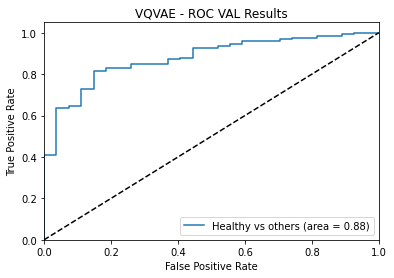

5.916335153579712
0.8769414575866189


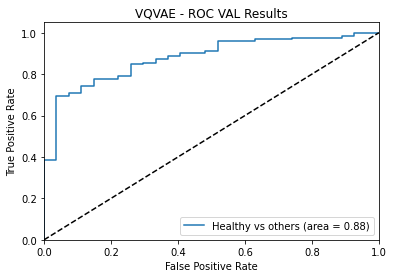

5.76876178741455
0.8784348864994027


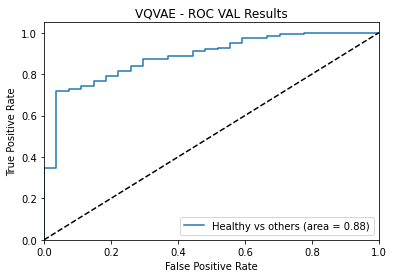

5.6446520471572885
0.8847072879330944


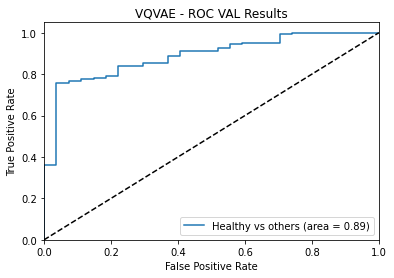

5.538229484558109
0.8873954599761051


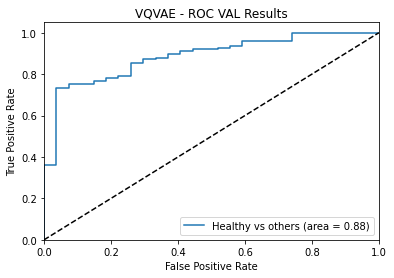

5.444314427375793
0.8847072879330944


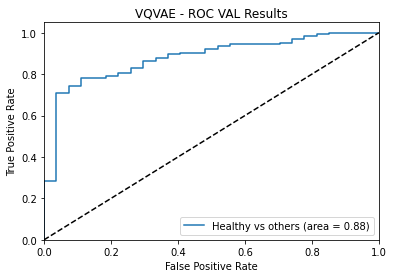

5.356721019744873
0.8775388291517323


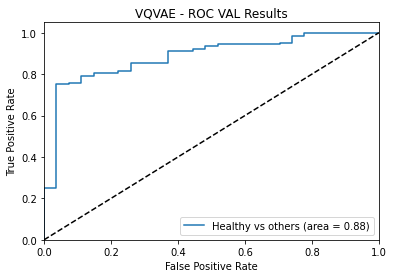

5.2817280483245845
0.8841099163679809


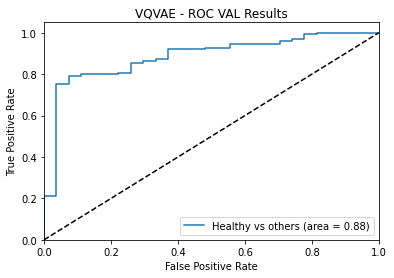

5.21239013671875
0.8832138590203106


In [26]:
img_roc_auc_all_test = roc_results(test_loader,perces)

In [27]:
def resample_anomaly(enface_img,model,feat_ext_mdl, threshold_log_p, n ):

#     x = torch.from_numpy(enface_img).to("cuda").float()
    x = enface_img/255
    model.eval()
    #Use VQ-VAE to encode original image\n,
    codes = model.retrieve_codes(x)
    code_size = codes.shape[-2:]
    with torch.no_grad():
        loss_original = model.loss(x, reduction='none')['loss']
        alignment_loss = torch.mean(feat_ext_mdl.loss(x)['alignment_loss'], 1)

        samples = codes.clone().unsqueeze(1).repeat(1,n,1,1).reshape(x.unsqueeze(0).shape[0]*n,*code_size)
        # Iterate through latent variables. 
        for r in range(code_size[0]):
            for c in range(code_size[1]):
                logits = model.forward_latent(samples)[:, :, r, c]
                loss = F.cross_entropy(logits, samples[:, r, c], reduction='none')
                loss_original[:,r,c] = loss.cpu().numpy()
                # Replace sample if above threshold
                probs = F.softmax(logits, dim=1)
                samples[loss > threshold_log_p, r, c] = torch.multinomial(probs, 1).squeeze(-1)[loss > threshold_log_p]

    # upscale loss
        up_scl = 8
        # mean_loss = raster_loss_original.max(axis=0        # print(mean_loss[0].max())
        upscale_loss = np.kron(loss_original, np.ones((up_scl,up_scl)))
        # remove values less than the threshold
        for u in range(upscale_loss.shape[1]):
            for j in range(upscale_loss.shape[2]):
                if(upscale_loss[0][u][j] < threshold_log_p):
                    upscale_loss[0][u][j] = float('nan')

        # mean_samples = torch.max(raster_samples, 0)
        # Retrieve z for the latent codes
        z = model.feature_extractor_model.codebook.embedding(samples)
        z = z.squeeze(1).permute(0,3,1,2).contiguous()

        # Decode to pixel space splitting computation in batches\n,
        x_tilde = []
        for i in range(enface_img.shape[0]):
            x_tilde.append(model.feature_extractor_model.decode(z[i*n:(i+1)*n]))
        x_tilde = torch.cat(x_tilde)

        decoded_image = x_tilde.reshape(1,n,*enface_img.shape[-2:])
        decoded_latent = samples.reshape(1,n,*code_size)
    return decoded_image,loss_original, upscale_loss


In [28]:
def restore(model,feat_ext_mdl, n, img, threshold_log_p = 5):
    """ Generate n restorations of images
        Returns restorations, both images and codes """
    
    model.eval()
        
    #Use VQ-VAE to encode original image
    codes = model.retrieve_codes(img)
    code_size = codes.shape[-2:]
    
    with torch.no_grad():
        loss_original = model.loss(img, reduction='none')['loss'].clone().unsqueeze(1).repeat(1,n,1,1)
        alignment_loss = torch.mean(feat_ext_mdl.loss(img)['alignment_loss'], 1)
        samples = codes.clone().unsqueeze(1).repeat(1,n,1,1).reshape(img.shape[0]*n,*code_size)
        
        # Iterate through latent variables. 
        for r in range(code_size[0]):
            for c in range(code_size[1]):

                logits = model.forward_latent(samples)[:, :, r, c]
                loss = F.cross_entropy(logits, samples[:, r, c], reduction='none')
                loss_original[:,:,r,c] = loss
                # Replace sample if above threshold
                probs = F.softmax(logits, dim=1)
                samples[loss > threshold_log_p, r, c] = torch.multinomial(probs, 1).squeeze(-1)[loss > threshold_log_p]
        
        # Retrieve z for the latent codes
        z = model.feature_extractor_model.codebook.embedding(samples.unsqueeze(1))
        z = z.squeeze(1).permute(0,3,1,2).contiguous()
        
        # Decode to pixel space splitting computation in batches
        x_tilde = []
        for i in range(img.shape[0]):
            x_tilde.append(model.feature_extractor_model.decode(z[i*n:(i+1)*n]))
        x_tilde = torch.cat(x_tilde)
              
    return x_tilde.reshape(img.shape[0],n,*img.shape[-2:]), samples.reshape(img.shape[0],n,*code_size), loss_original, alignment_loss



In [29]:
mood_train = []
label_train = []
for img, label in train_loader:
    mood_train.append(img.tolist())
    label_train.append(label.tolist())
label_train = [x for xs in label_train for x in xs]
label_train = np.array(label_train)

mood_train = [x for xs in mood_train for x in xs]
mood_train = np.array(mood_train)

In [30]:
mood_train.shape

(214, 512, 512)

In [31]:
mood_train_avg = mood_train.mean(axis=0)

Text(0.5, 1.0, 'Mean over Train Dataset')

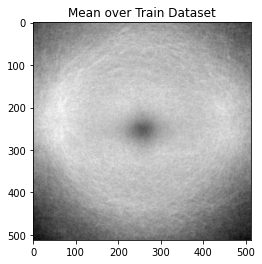

In [32]:
plt.imshow(mood_train_avg, cmap='gray')
plt.title('Mean over Train Dataset')

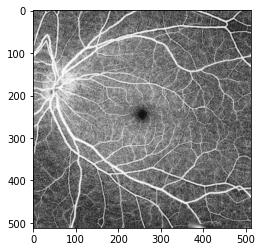

In [33]:
plt.imshow(mood_train[9], cmap='gray')


In [34]:
xx = mood_train[0].copy()

xx[50:200,300:450] = 0

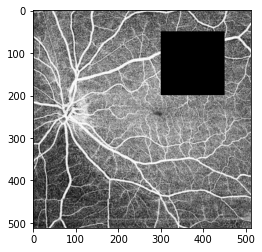

In [35]:
plt.imshow(xx, cmap='gray')

In [36]:
img.shape

torch.Size([1, 512, 512])

7.2155454826355


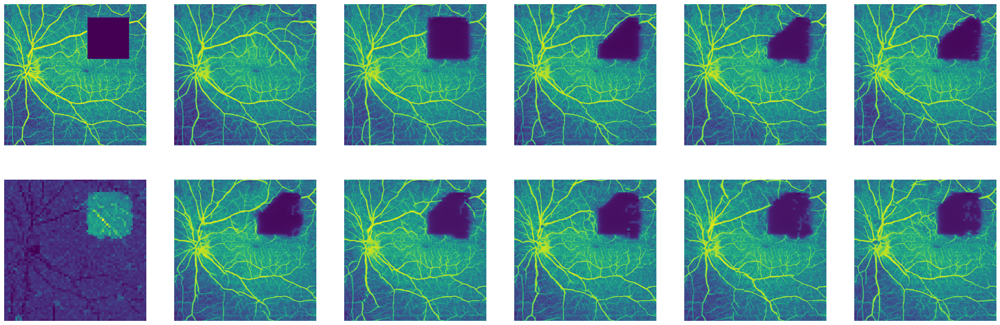

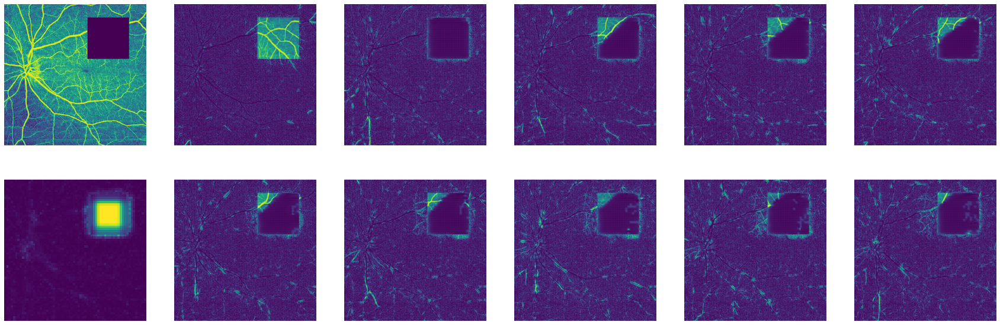

6.6488114356994625


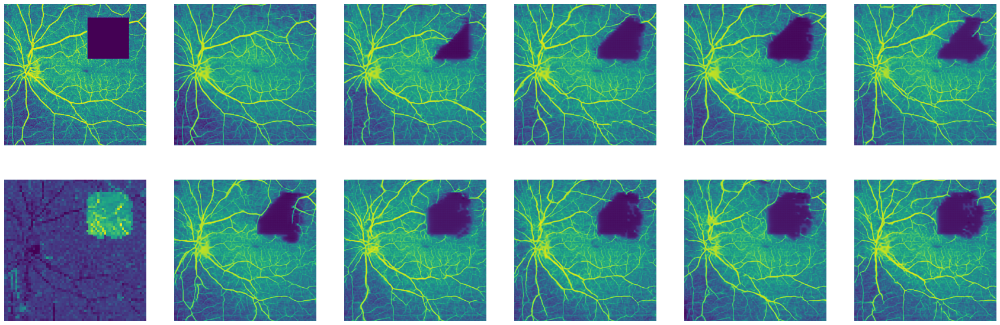

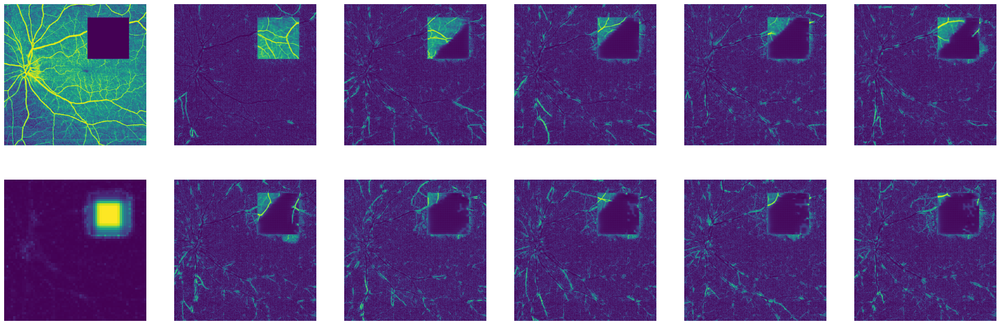

6.324940805435182


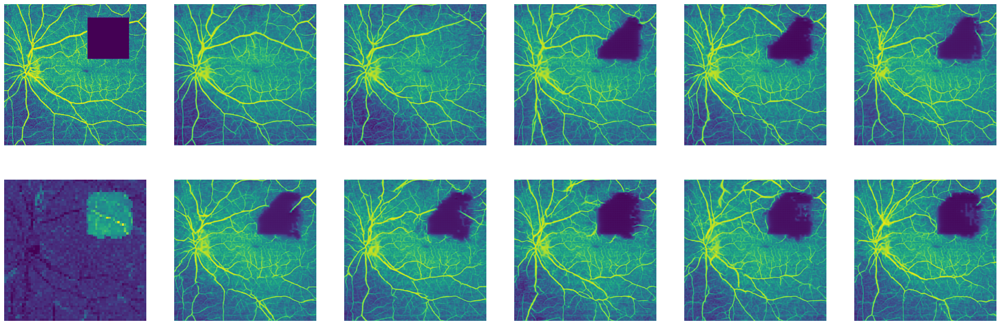

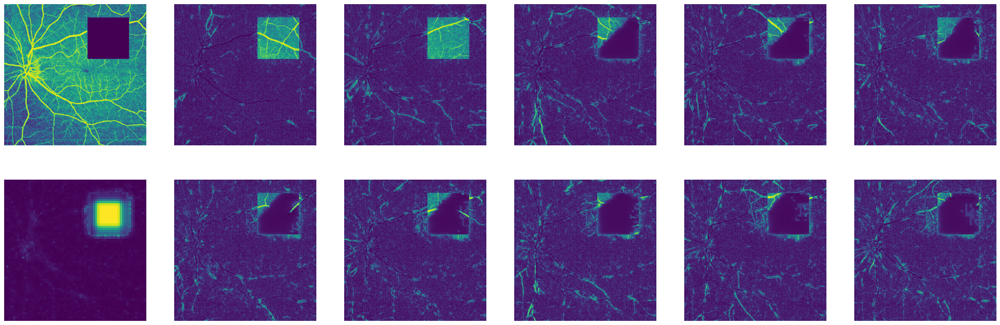

6.093932151794434


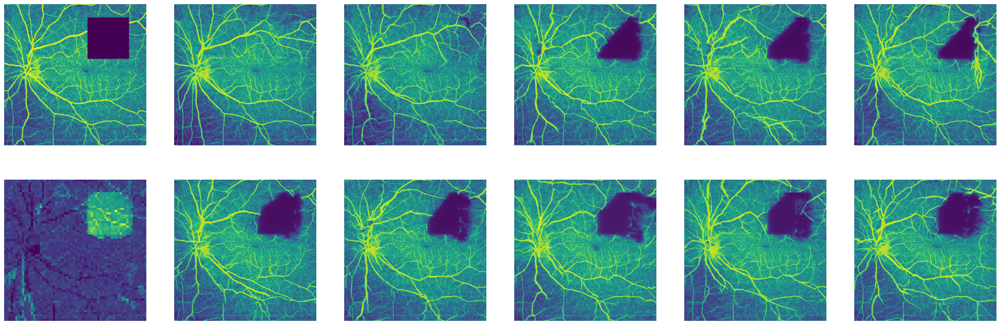

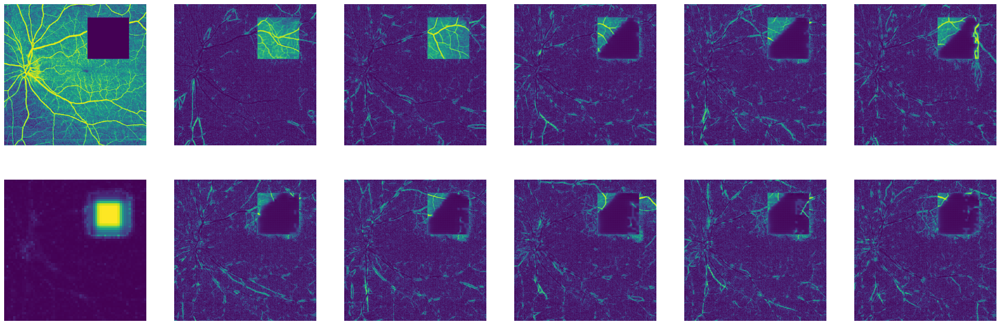

5.916335153579712


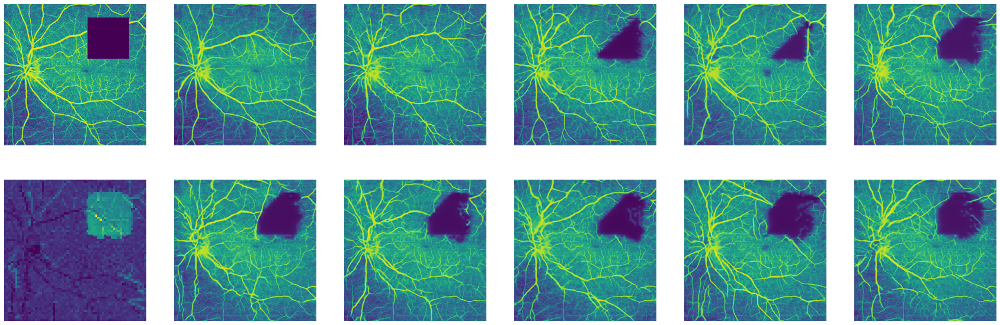

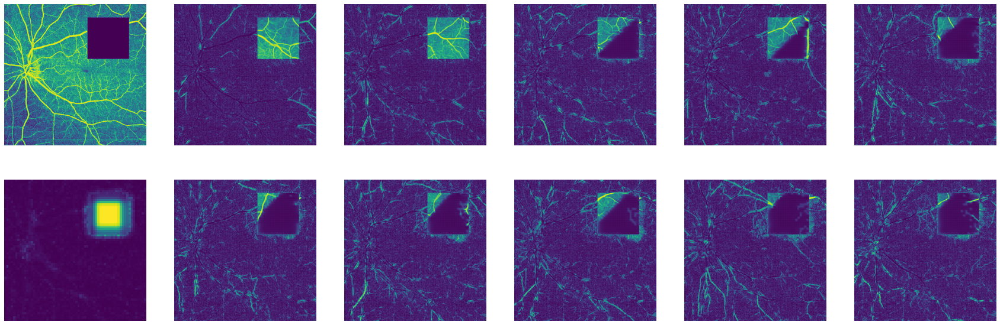

5.76876178741455


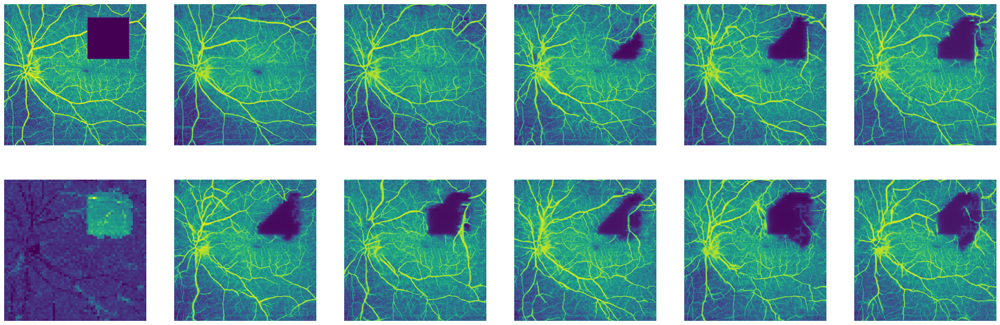

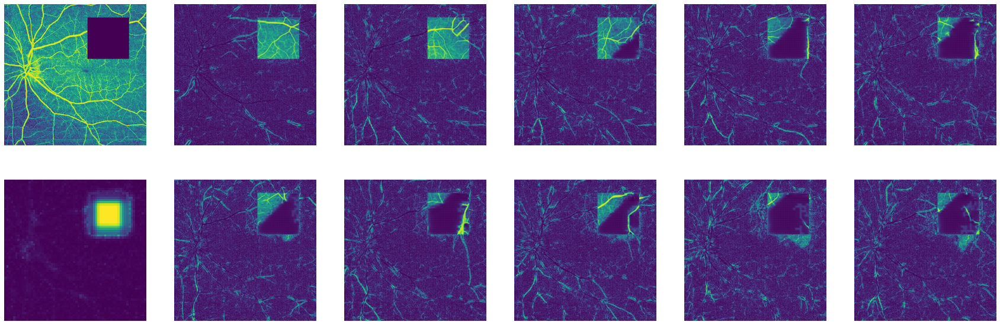

5.6446520471572885


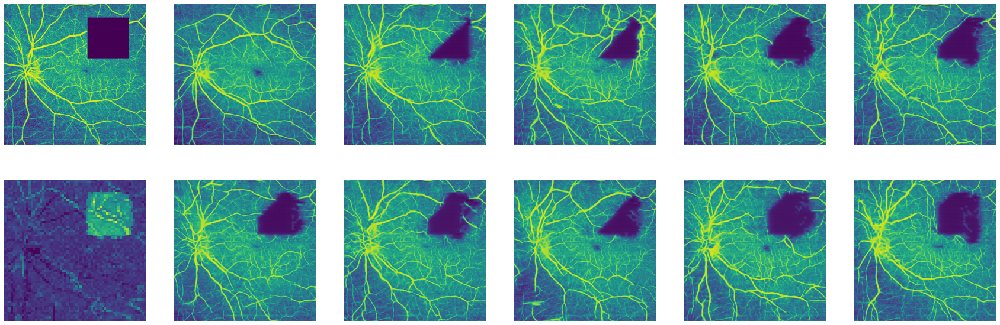

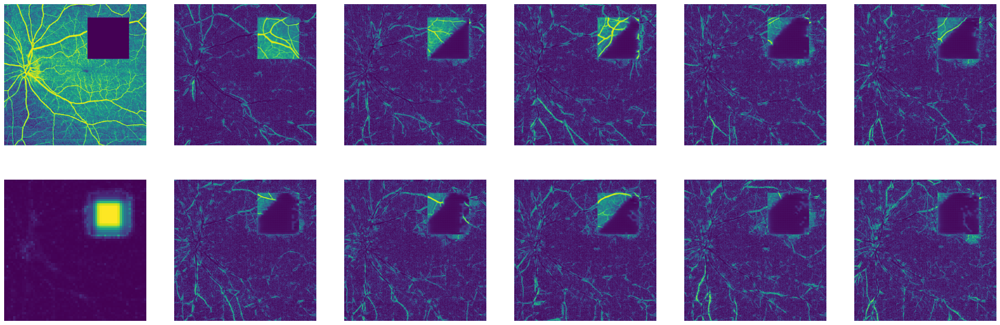

5.538229484558109


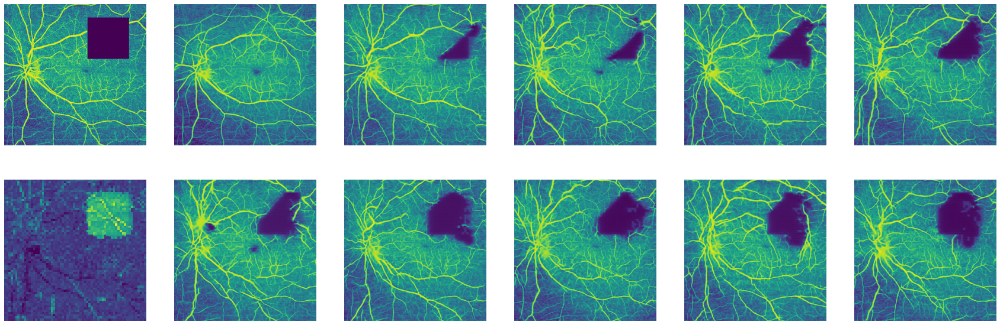

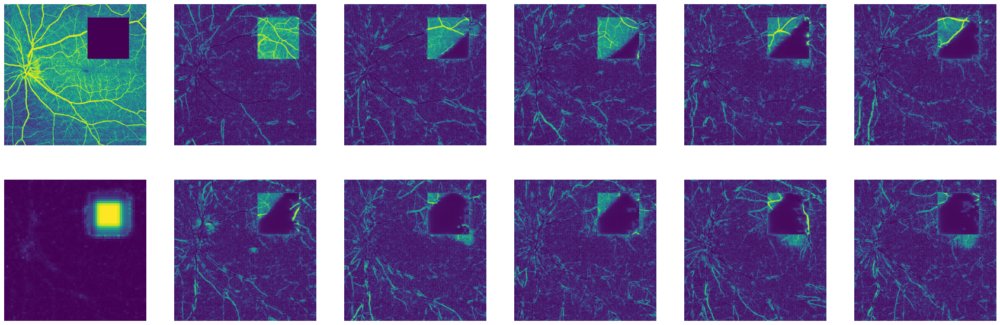

5.444314427375793


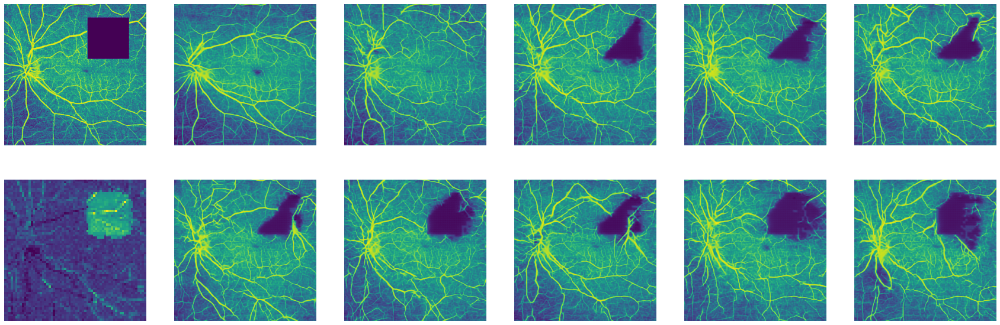

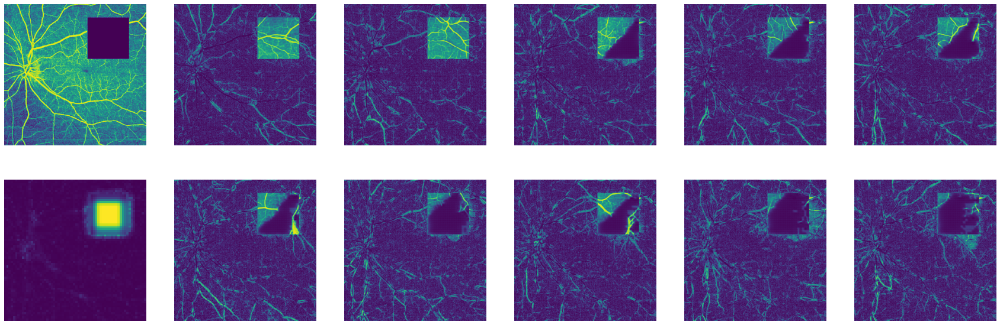

5.356721019744873


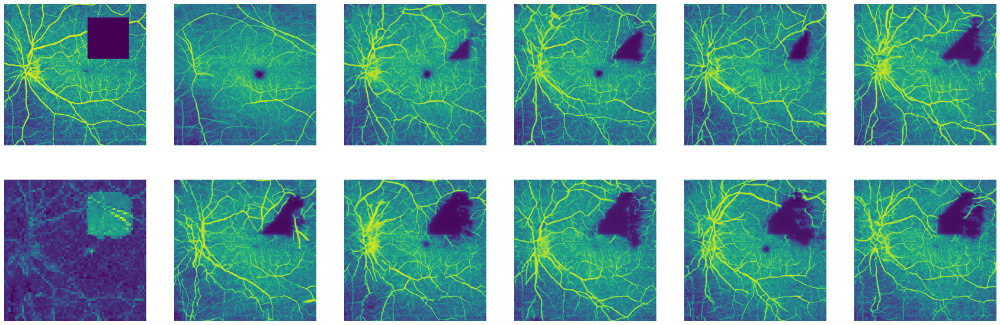

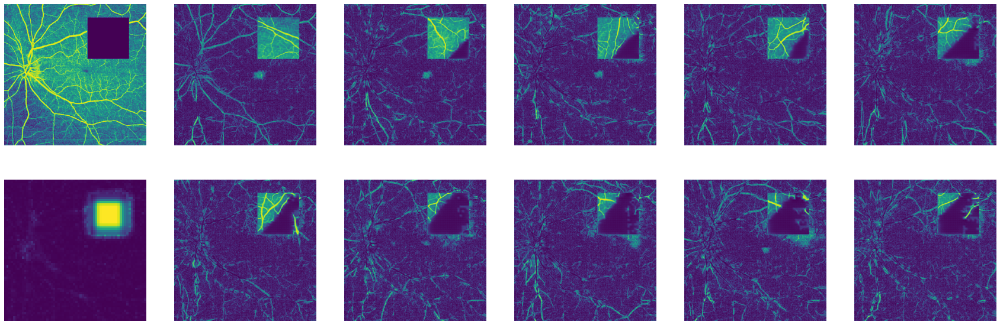

5.2817280483245845


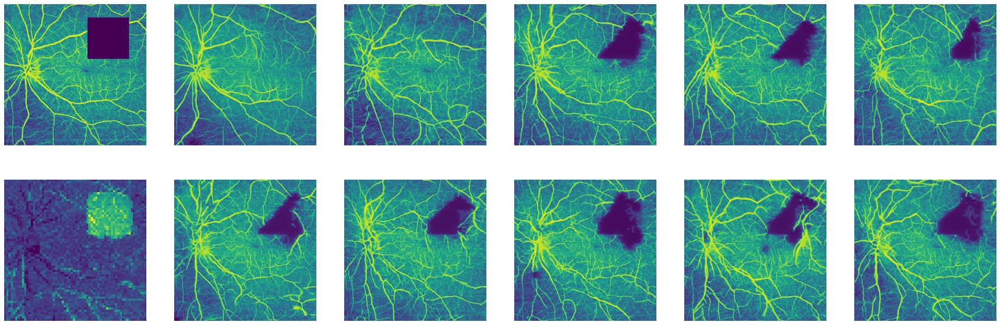

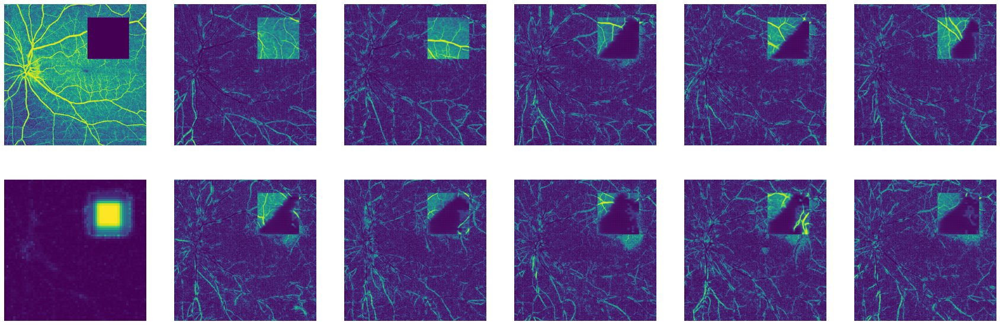

5.21239013671875


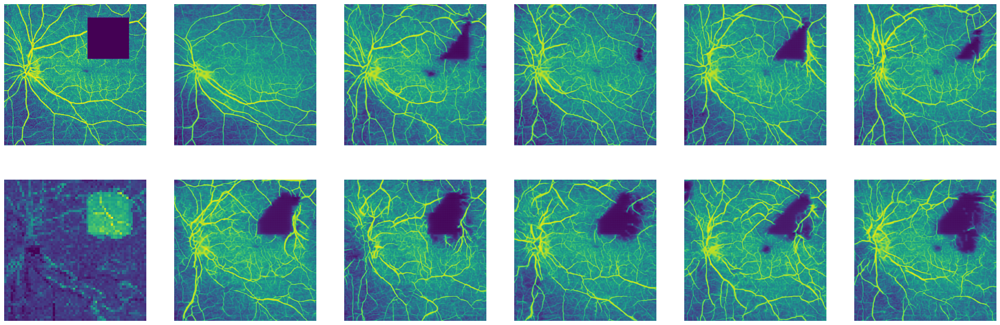

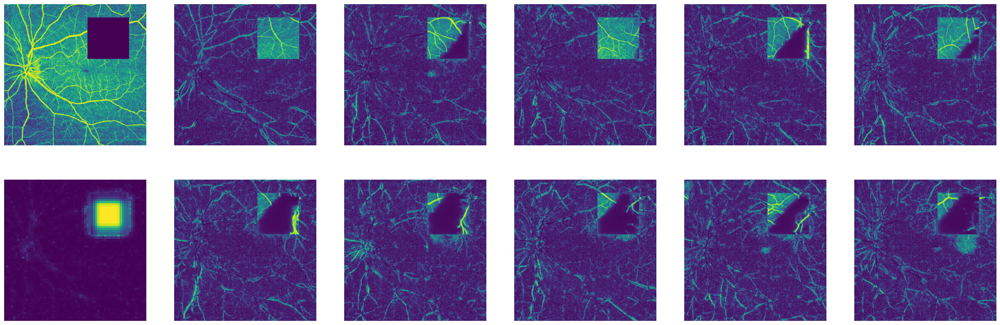

In [37]:
for thresh in perces: 
    mood_test_reconstructions = []
    mood_test_latent = []
    print(thresh)
    print('=================================================')
    img = torch.tensor(xx).to(device).unsqueeze(0).float()

    x_tilde, latent_sample, loss_original, alignment_loss= restore(model,feat_ext_mdl,n=15,img=img, threshold_log_p=thresh)
    mood_test_reconstructions.append(x_tilde)
    mood_test_latent.append(latent_sample)
    img_no = 0

    fig, ax = plt.subplots(2,6, figsize=(30,10))
    ax[0,0].imshow(img[0].cpu())
    ax[0,0].axis('off')
    ax[1,0].imshow(loss_original[img_no][0].cpu())
    ax[1,0].axis('off')

    for i in range(1,6):
        ax[0,i].imshow(mood_test_reconstructions[img_no][0][i-1].cpu())
        ax[0,i].axis('off')

    for i in range(1,6):
        ax[1,i].imshow(mood_test_reconstructions[img_no][0][i-1+5].cpu())
        ax[1,i].axis('off')
    plt.show()
    img_no = 0



    fig, ax = plt.subplots(2,6, figsize=(30,10))
    ax[0,0].imshow(img[0].cpu())
    ax[0,0].axis('off')
    ax[1,0].imshow(alignment_loss[img_no].cpu())
    ax[1,0].axis('off')
    for i in range(1,6):
        tmp = np.abs(mood_test_reconstructions[img_no][0,i-1].cpu() - img[0].cpu())
        ax[0,i].imshow(tmp)
        ax[0,i].axis('off')
    for i in range(1,6):
        tmp = np.abs(mood_test_reconstructions[img_no][0,i-1+5].cpu()- img[0].cpu())
        ax[1,i].imshow(tmp)    
        ax[1,i].axis('off')
    plt.show()

In [ ]:
mood_valid = []
label_valid = []
for img, label in valid_loader:
    mood_valid.append(img.tolist())
    label_valid.append(label.tolist())
label_valid = [x for xs in label_valid for x in xs]
label_valid = np.array(label_valid)

mood_valid = [x for xs in mood_valid for x in xs]
mood_valid = np.array(mood_valid)

In [ ]:
mood_valid_avg = mood_valid.mean(axis=0)

In [ ]:
plt.imshow(mood_valid_avg, cmap='gray')
plt.title('Mean over validation dataset')

In [ ]:
mood_test = []
label_test = []
for img, label in valid_loader:
    mood_test.append(img)
    label_test.append(label.item())

label_test = np.array(label_test)


In [ ]:
plt.imshow(mood_test[13][0])

In [ ]:
loss_original.shape

In [ ]:
for thresh in perces: 
    mood_test_reconstructions = []
    mood_test_latent = []
    for X in mood_test[9]:

        img = X.to(device).unsqueeze(0).float()

        x_tilde, latent_sample, loss_original, alignment_loss= restore(model,feat_ext_mdl,n=15,img=img, threshold_log_p=thresh)
        mood_test_reconstructions.append(x_tilde)
        mood_test_latent.append(latent_sample)
        img_no = 0

        fig, ax = plt.subplots(2,6, figsize=(30,10))
        ax[0,0].imshow(mood_test[9][0])
        ax[0,0].axis('off')
        ax[1,0].imshow(loss_original[img_no][0].cpu())
        ax[1,0].axis('off')

        for i in range(1,6):
            ax[0,i].imshow(mood_test_reconstructions[img_no][0][i-1].cpu())
            ax[0,i].axis('off')

        for i in range(1,6):
            ax[1,i].imshow(mood_test_reconstructions[img_no][0][i-1+5].cpu())
            ax[1,i].axis('off')
        plt.show()
        img_no = 0

        

        fig, ax = plt.subplots(2,6, figsize=(30,10))
        ax[0,0].imshow(mood_test[9][0])
        ax[0,0].axis('off')
        ax[1,0].imshow(alignment_loss[img_no])
        ax[1,0].axis('off')
        for i in range(1,6):
            tmp = np.abs(mood_test_reconstructions[img_no][0,i-1].cpu() - mood_test[9][0])
            ax[0,i].imshow(tmp)
            ax[0,i].axis('off')
        for i in range(1,6):
            tmp = np.abs(mood_test_reconstructions[img_no][0,i-1+5].cpu()- mood_test[9][0])
            ax[1,i].imshow(tmp)    
            ax[1,i].axis('off')
        plt.show()
        
        
    mood_test_reconstructions = []
    mood_test_latent = []   
    for X in mood_test[13]:

        img = X.to(device).unsqueeze(0).float()

        x_tilde, latent_sample, loss_original, alignment_loss= restore(model,feat_ext_mdl,n=15,img=img, threshold_log_p=thresh)
        mood_test_reconstructions.append(x_tilde)
        mood_test_latent.append(latent_sample)
        img_no = 0

        fig, ax = plt.subplots(2,6, figsize=(30,10))
        ax[0,0].imshow(mood_test[13][0])
        ax[0,0].axis('off')
        ax[1,0].imshow(loss_original[img_no][0])
        ax[1,0].axis('off')

        for i in range(1,6):
            ax[0,i].imshow(mood_test_reconstructions[img_no][0][i-1].cpu())
            ax[0,i].axis('off')

        for i in range(1,6):
            ax[1,i].imshow(mood_test_reconstructions[img_no][0][i-1+5].cpu())
            ax[1,i].axis('off')
        plt.show()
        img_no = 0



        fig, ax = plt.subplots(2,6, figsize=(30,10))
        ax[0,0].imshow(mood_test[13][0])
        ax[0,0].axis('off')
        ax[1,0].imshow(alignment_loss[img_no])
        ax[1,0].axis('off')
        for i in range(1,6):
            tmp = np.abs(mood_test_reconstructions[img_no][0,i-1].cpu() - mood_test[13][0])
            ax[0,i].imshow(tmp)
            ax[0,i].axis('off')
        for i in range(1,6):
            tmp = np.abs(mood_test_reconstructions[img_no][0,i-1+5].cpu()- mood_test[13][0])
            ax[1,i].imshow(tmp)    
            ax[1,i].axis('off')
        plt.show()

In [ ]:
img_no = 0

fig, ax = plt.subplots(2,6, figsize=(30,10))
ax[0,0].imshow(mood_test[9][0])
ax[0,0].axis('off')
# ax[1,0].imshow(mood_test_seg[img_no])
# ax[1,0].axis('off')

for i in range(1,6):
    ax[0,i].imshow(mood_test_reconstructions[img_no][0][i-1].cpu())
    ax[0,i].axis('off')

for i in range(1,6):
    ax[1,i].imshow(mood_test_reconstructions[img_no][0][i-1+5].cpu())
    ax[1,i].axis('off')
plt.tight_layout()

In [ ]:
img_no = 0



fig, ax = plt.subplots(2,6, figsize=(30,10))
ax[0,0].imshow(mood_test[9][0])
ax[0,0].axis('off')
# ax[1,0].imshow(mood_test_seg[img_no][slice_no])
# ax[1,0].axis('off')
for i in range(1,6):
    tmp = np.abs(mood_test_reconstructions[img_no][0,i-1].cpu() - mood_test[img_no][0])
    ax[0,i].imshow(tmp)
    ax[0,i].axis('off')
for i in range(1,6):
    tmp = np.abs(mood_test_reconstructions[img_no][0,i-1+5].cpu()- mood_test[img_no][0])
    ax[1,i].imshow(tmp)    
    ax[1,i].axis('off')
plt.tight_layout()

In [ ]:
img = torch.from_numpy(np.concatenate([x for x in mood_test]))
img_tilde = torch.cat(mood_test_reconstructions)
# img_seg = torch.from_numpy(np.concatenate(mood_test_seg))

In [ ]:

smooth = nn.Sequential(nn.MaxPool2d(kernel_size=3,padding=1,stride=1),
                       nn.AvgPool2d(kernel_size=(7,7),padding=(3,3),stride=1),
                      ).to(device)

In [ ]:
# L1 distance restoration vs original image
diffs = torch.abs(img[0].unsqueeze(0).to(device).float()-img_tilde)

# Calculate restoration weight based on restoration similarity to original image
sim_imgwise = torch.mean(diffs,(0,1)).unsqueeze(0).unsqueeze(1)

sim_imgwise = torch.softmax(3/sim_imgwise,1)
print(sim_imgwise.shape)
# Pixel-wise score after weight 
diffs = (diffs*sim_imgwise).sum(1,keepdims=True)

# Post-process using Min Pool and average filter
diffs = diffs.squeeze().unsqueeze(0).unsqueeze(0)
print(diffs.shape)
smooth_diffs = -smooth(-diffs)
print(smooth_diffs.shape)
smooth_diffs = smooth_diffs.squeeze().unsqueeze(0)

# # Average precission
# metrics.average_precision_score(img_seg.flatten(),smooth_diffs.flatten().clamp_max(1.).cpu() / 1.)

In [ ]:
diffs.max()

In [ ]:
plt.imshow(diffs[0][0].cpu().detach().numpy())


In [ ]:

plt.imshow(smooth_diffs.squeeze().cpu())


In [ ]:
# dropout_predictions = mood_test_reconstructions[0]
batch_mean = dropout_predictions.mean(dim=0)
batch_std = dropout_predictions.std(dim=0)
batch_pred_entropy = -torch.sum(batch_mean*batch_mean.log(),dim=0)
batch_mutual_info = batch_pred_entropy+torch.mean(torch.sum(dropout_predictions*dropout_predictions.log(),dim=-3),dim=0)
# .cpu().detach().numpy()

In [ ]:
batch_mutual_info.shape

In [ ]:
plt.imshow(batch_std[0].cpu().detach().numpy(),vmax=2)


In [ ]:
mood_test_reconstructions[0].shape

In [ ]:
threshold_log_p = 6
n=1
for img, label in valid_loader:
    x_img = img.to(device).float()
    alignment_loss=resample_anomaly(x_img,model, feat_ext_mdl,threshold_log_p, n )
    ghgh
#     decoded_image,loss_original, upscale_loss = resample.resample_anomaly(w[img_sample],model, threshold_log_p, n )